In [1]:
server_url = 'grpcs://dalle-flow.dev.jina.ai'
from docarray import Document

### Generation

Prompting tricks:
 - [A Guide to Writing Prompts for Text-to-image AI](https://docs.google.com/document/d/17VPu3U2qXthOpt2zWczFvf-AH6z37hxUbvEe1rJTsEc/edit?usp=sharing)
 - [CLIP Templates](https://docs.google.com/document/d/1j2IAumYz4iZopOTAAOcCUKbFXP0jHK8mRgD4NLFKkaw/edit?usp=sharing)

Submit to the server and visualize the results:

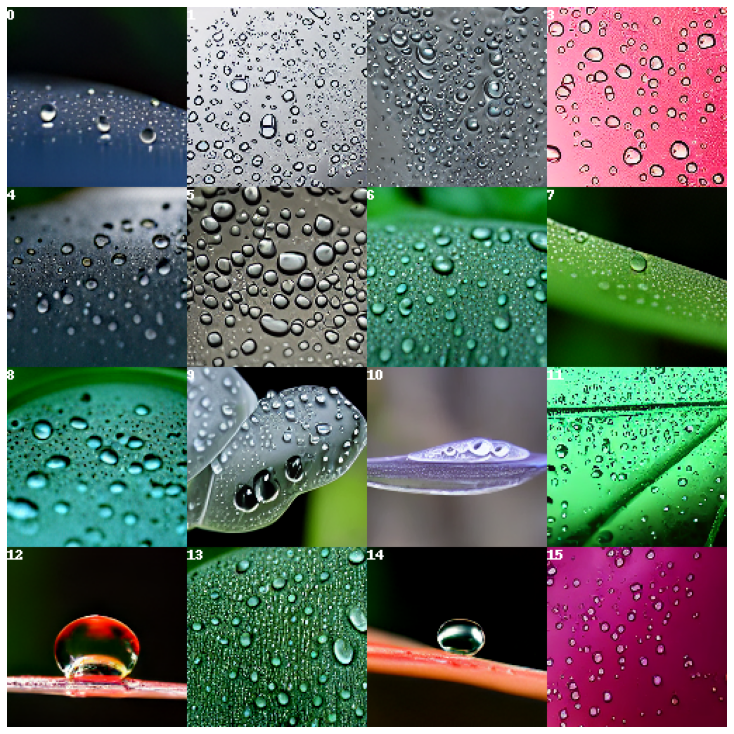

In [13]:
prompt = "droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

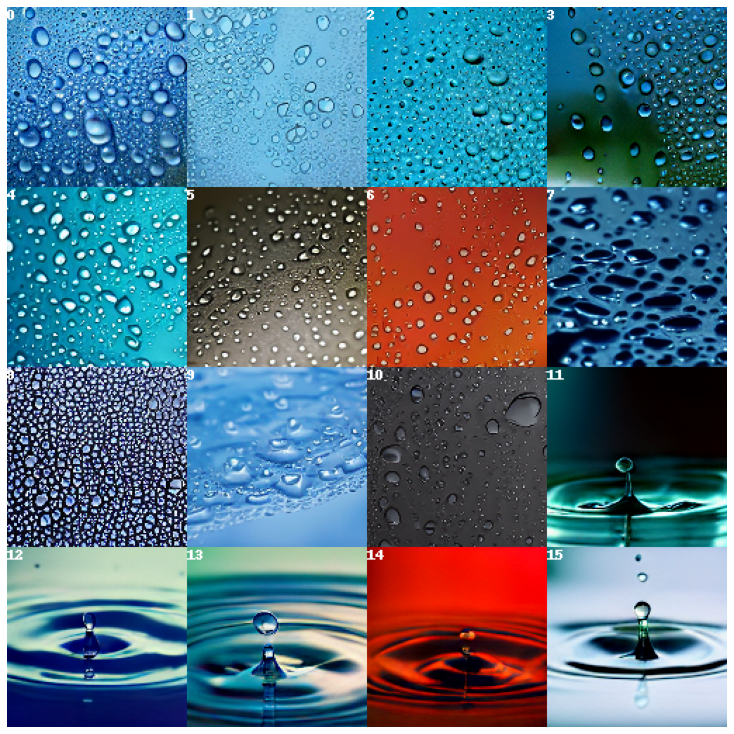

In [72]:
prompt = "water droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

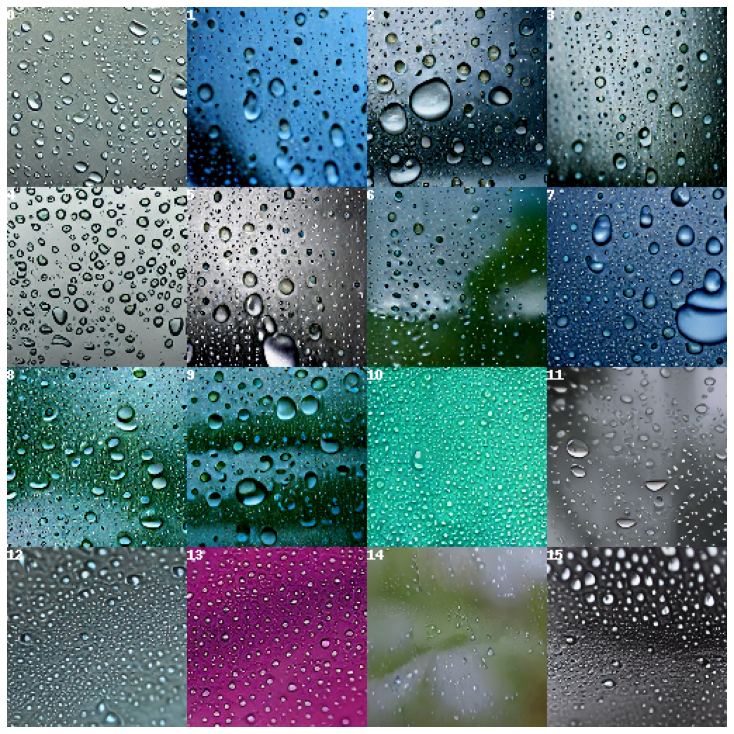

In [73]:
prompt = "rain droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

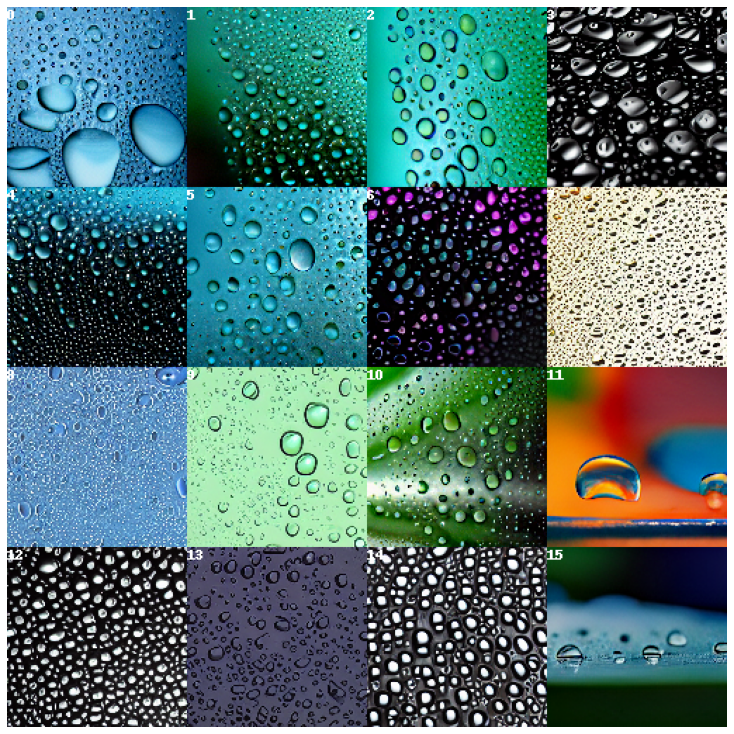

In [74]:
prompt = "abstract droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

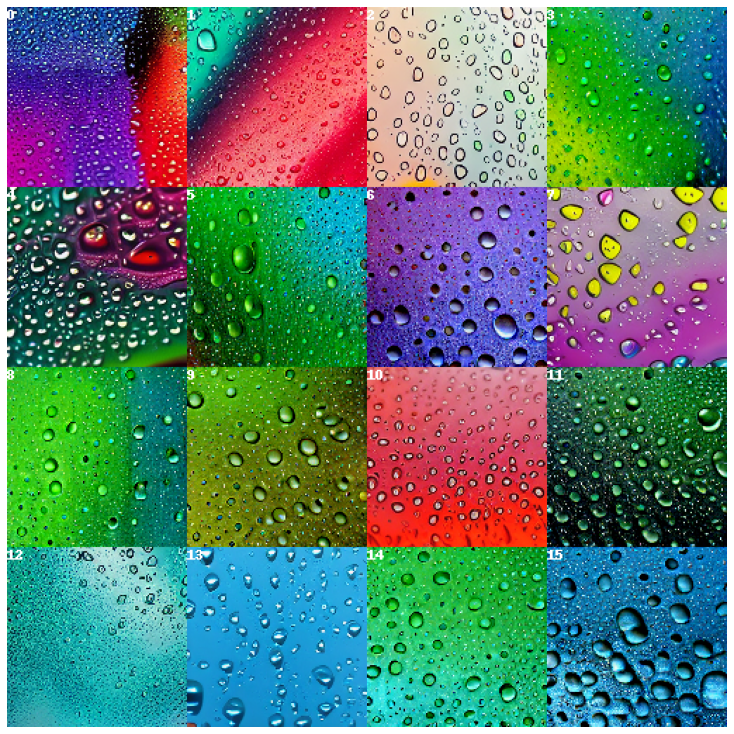

In [75]:
prompt = "colorful rain droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

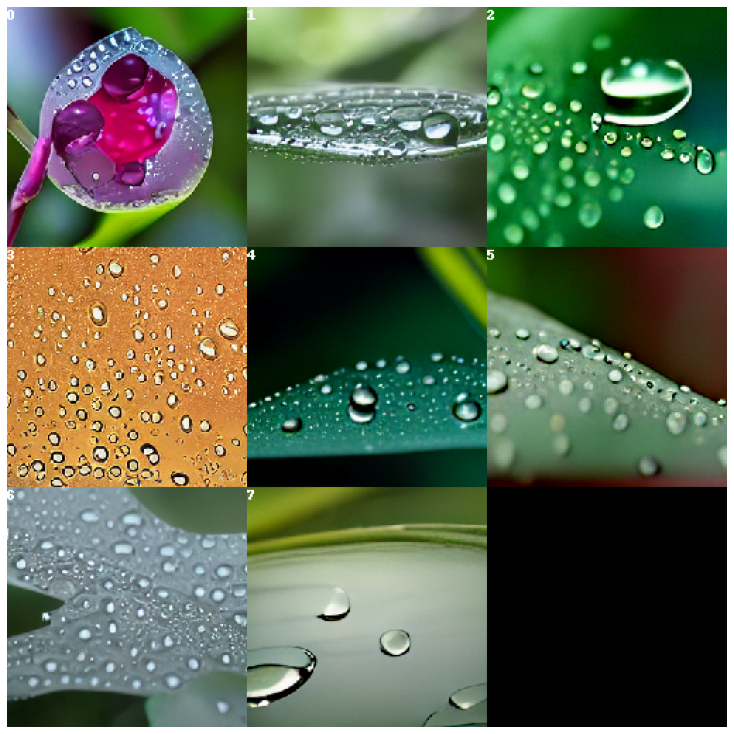

In [76]:
prompt = "beautiful droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 4}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

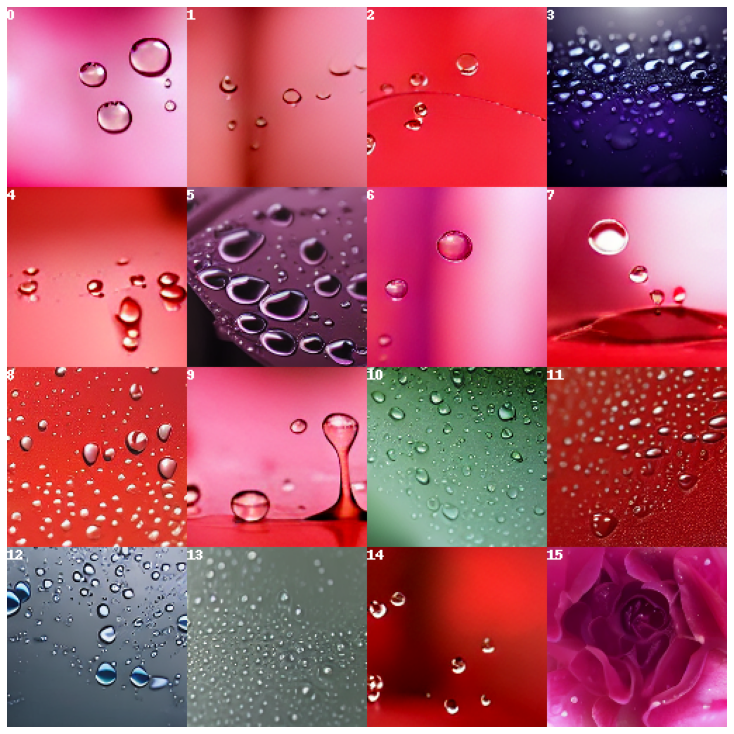

In [14]:
prompt = "romantic droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

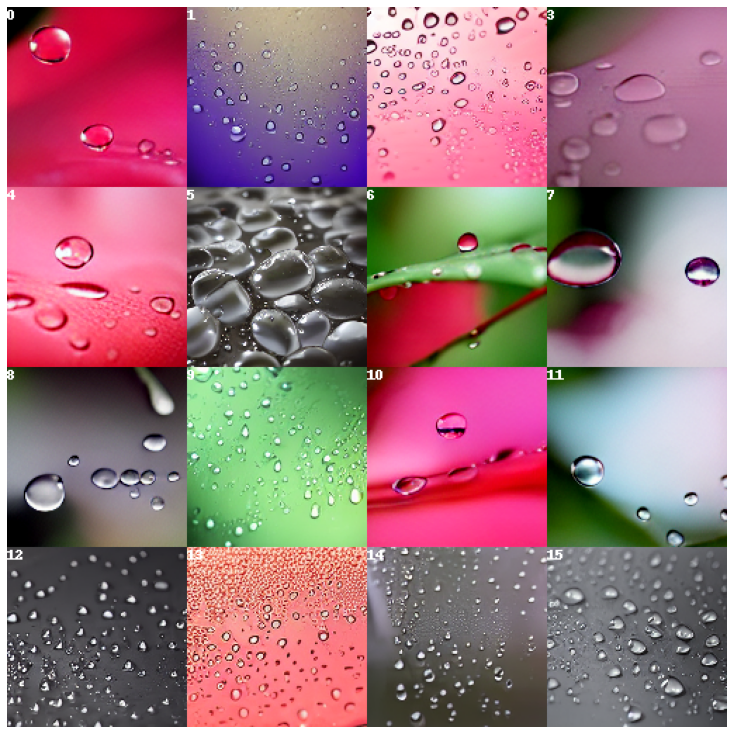

In [15]:
prompt = "droplets in romantic style"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

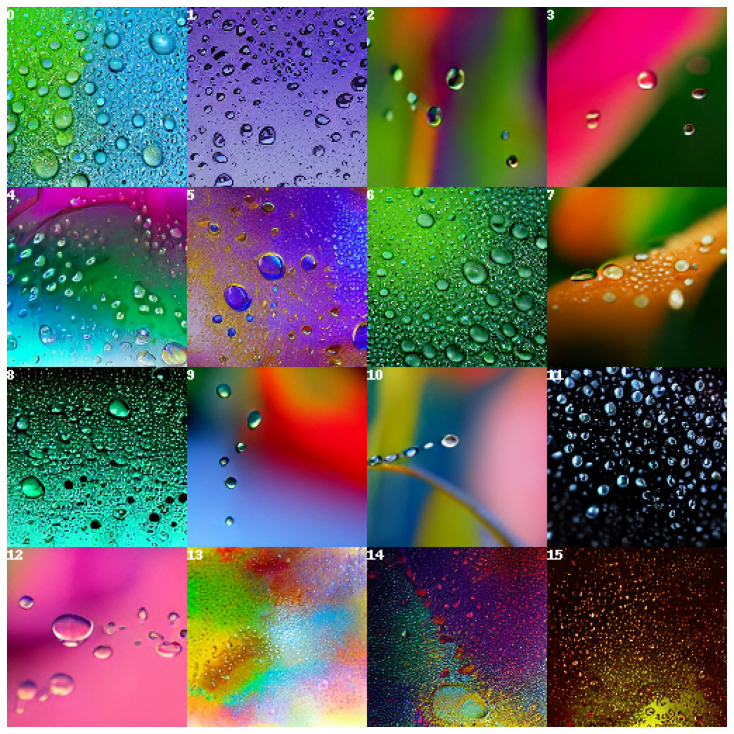

In [16]:
prompt = "droplets in impressionism style"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

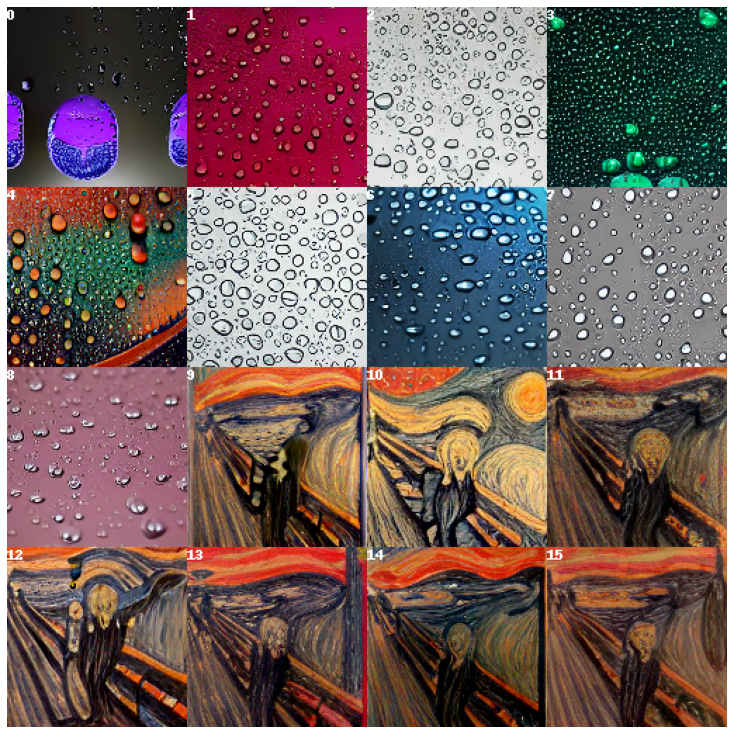

In [17]:
prompt = "droplets in expressionist style"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

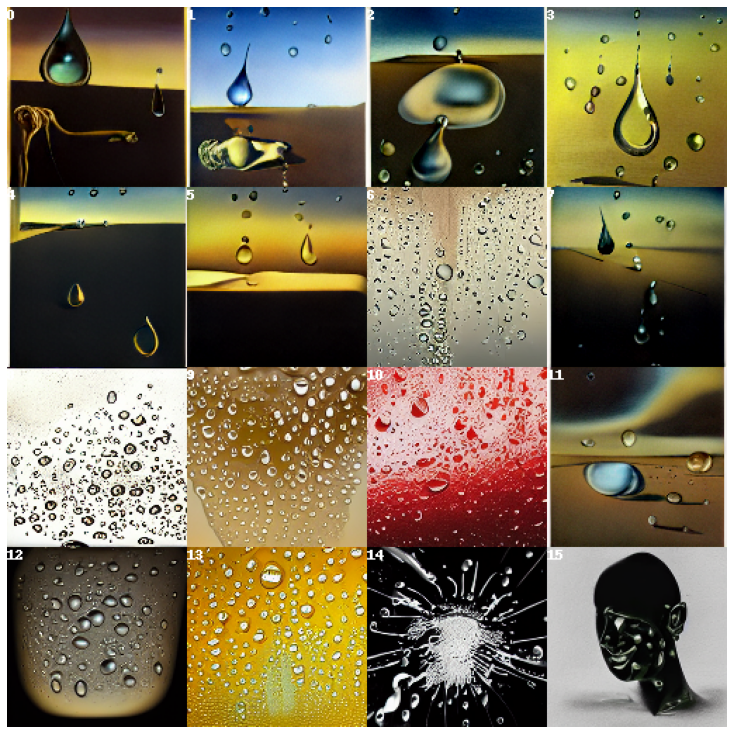

In [18]:
prompt = "droplets by Salvador Dali"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

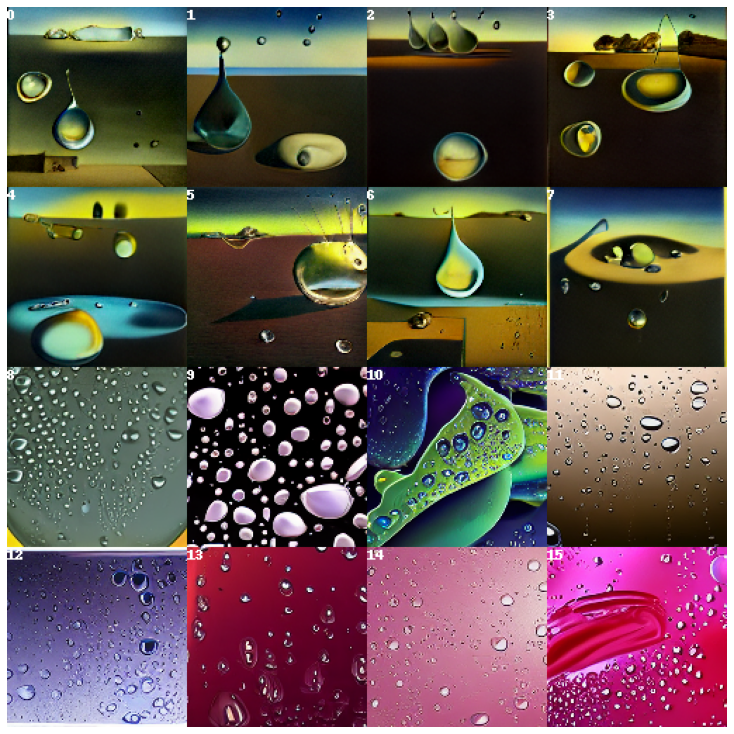

In [19]:
prompt = "droplets by Dali"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

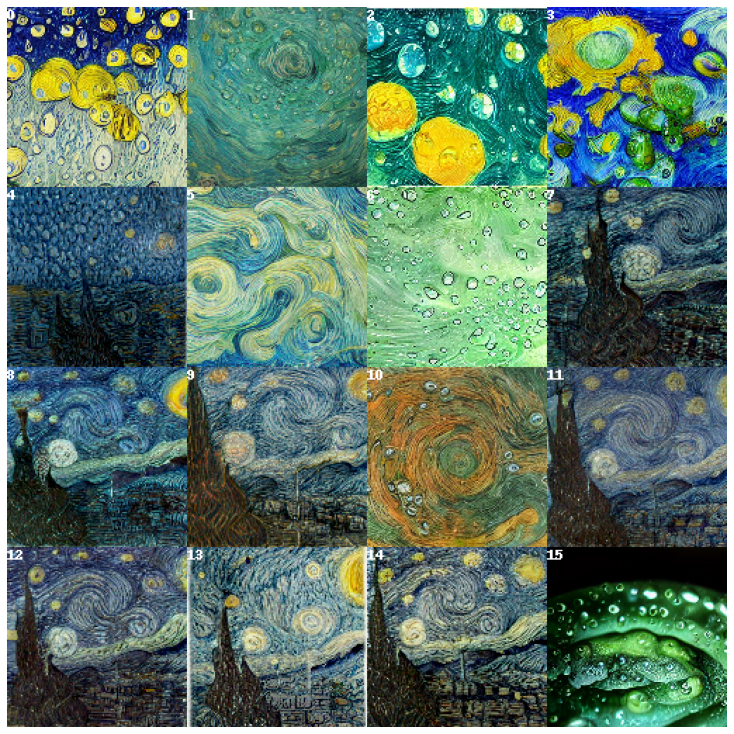

In [20]:
prompt = "droplets by Van Gogh"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

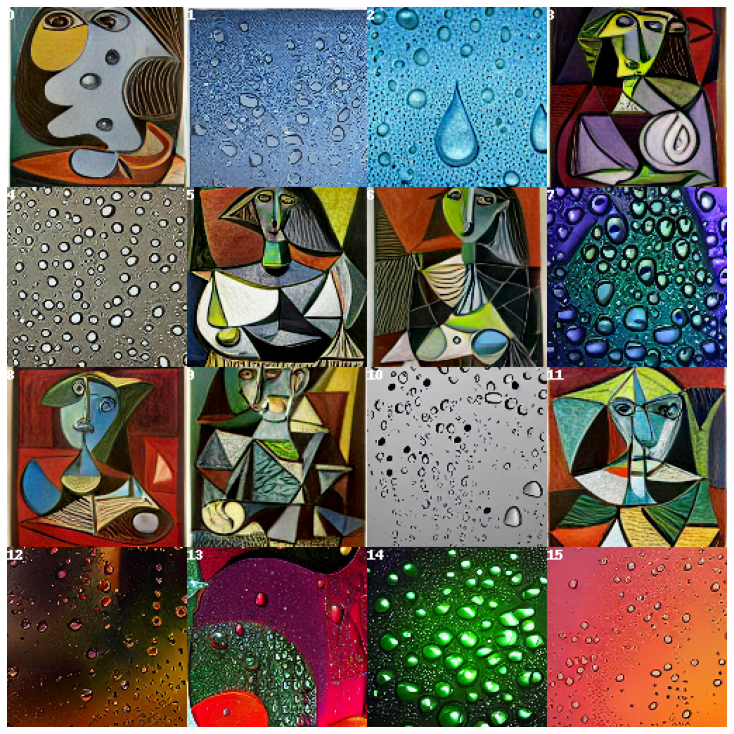

In [21]:
prompt = "droplets by Picasso"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

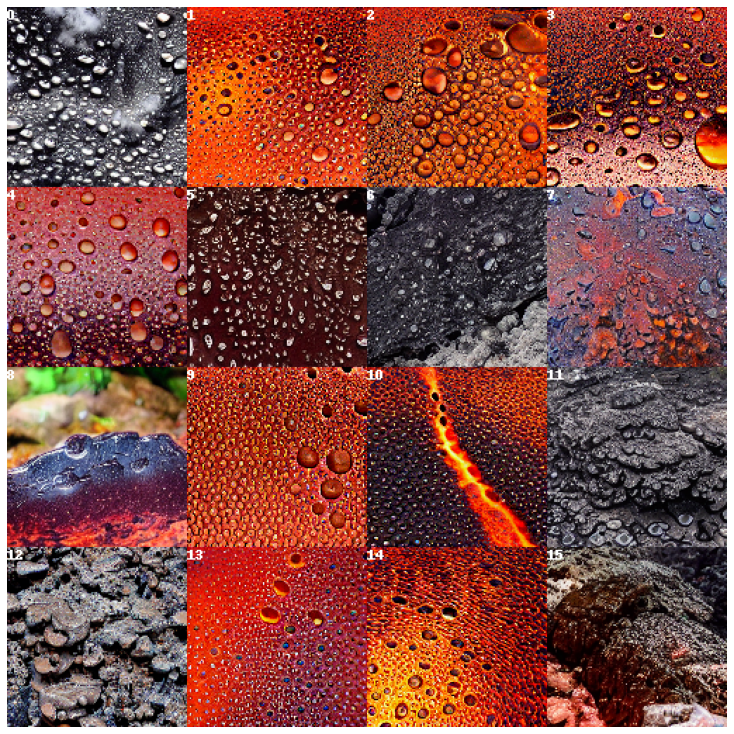

In [25]:
prompt = "droplets made out of lava"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

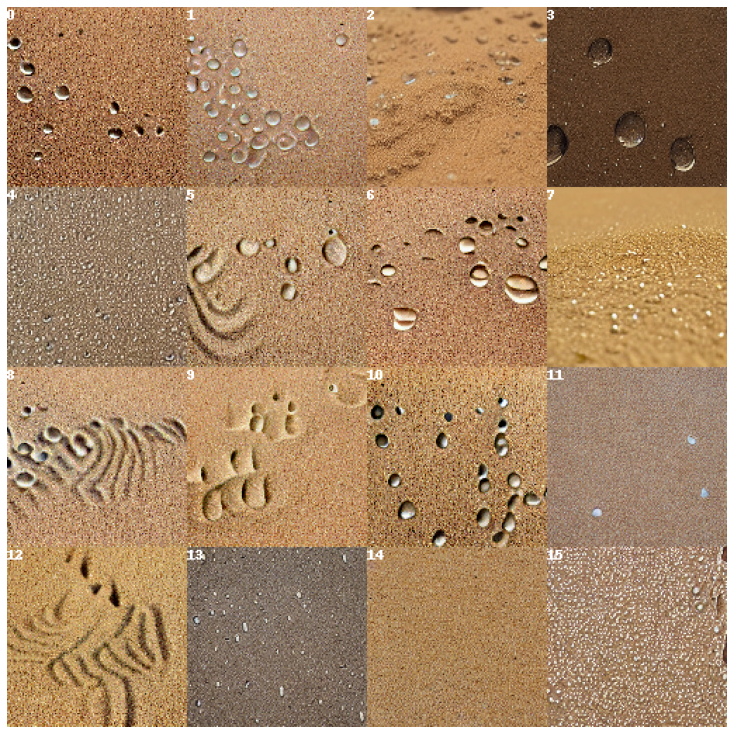

In [22]:
prompt = "droplets made out of sand"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

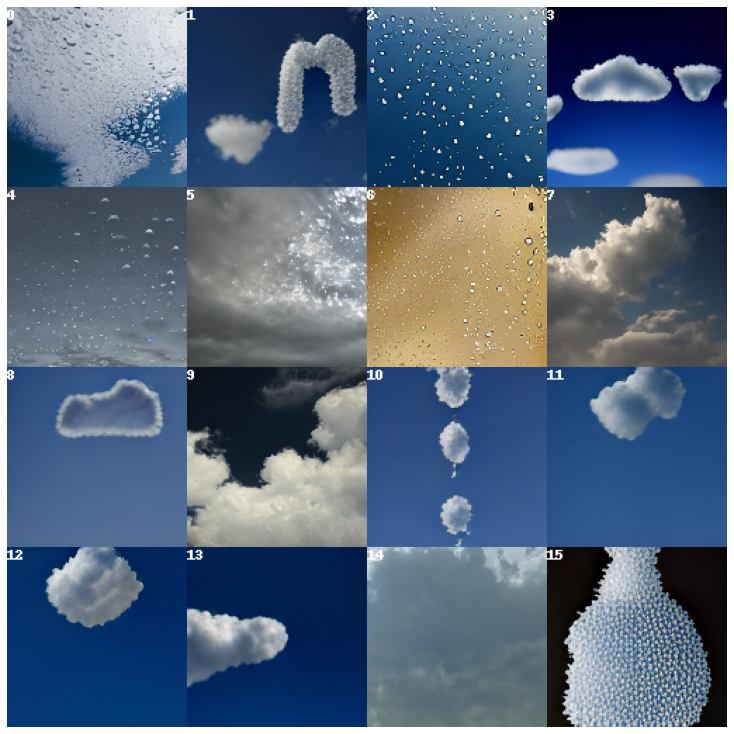

In [23]:
prompt = "droplets made out of clouds"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

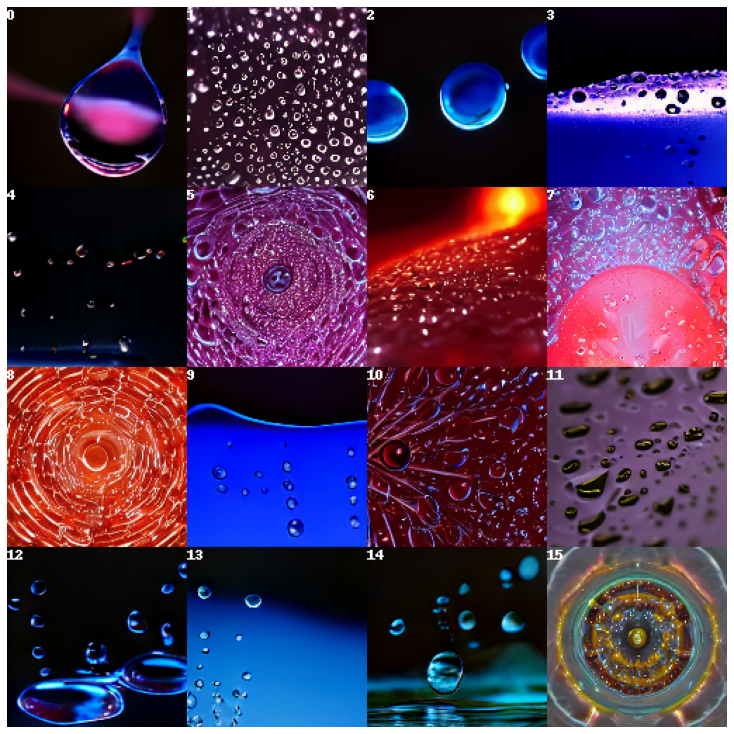

In [24]:
prompt = "droplets made out of plasma"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

## At scale generation

Instead of spinning up our own Docker image we can use Jina's server

In [ ]:
import random
import time

server_url = 'grpcs://dalle-flow.dev.jina.ai'
from docarray import Document

def random_string(length=10):
    return ''.join(random.choice('0123456789ABCDEF') for i in range(length))

def generate_images(prompt,):
    da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
    da = da[:8]
    time.sleep(2)
    for img in da:
        # upscale it to 1024 x 1024
        img = img.post(f'{server_url}/upscale')
        # save to file 
        img.save_uri_to_file(f'out/{random_string()}_{prompt}.png')
        time.sleep(2)


prompts = [
    'droplets',
    'droplets',
    'droplets',
    'water droplets',
    'water droplets',
    'water droplets',
    'lava rain droplets',
    'sand rain droplets',
    'rain droplets',
    'abstract droplets',
    'colorful rain droplets',
    'colorful rain droplets',
    'beautiful droplets',
    'modern droplets',
    'romantic droplets',
    'droplets in romantic style',
    'droplets in impressionism style',
    # 'droplets in expressionist style',
]
# authors = ["Toshi Yoshida", "Hiroshi Yoshida", "Ivan Bilibin", "Ivan Shishkin", "Kuniyoshi", "Ghibli", "h r giger"]
# prompts_authors = ['droplets' + ' by ' + author for author in authors]
# prompts.extend(prompts_authors)


import os
if not os.path.exists('out'):
    os.makedirs('out')


# shuffle the prompts
random.shuffle(prompts)
n = 1000
while n > 0:
    for prompt in prompts:
        try:    
            generate_images(prompt)
            print(f"{prompt}\n")
            n -= 16
            if n <= 0:
                break
        except Exception as e:
            pass